In [ ]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim

In [ ]:
#MSE,NMSE,PSNR,IF oraz SSIM

def mse(imgA, imgB):
    err = np.sum((imgA.astype(float) - imgB.astype(float)) ** 2)
    err /= float(imgA.shape[0] * imgA.shape[1])
    return err

def nmse(imgA, imgB):
    MSE_ki = mse(imgA, imgB) * (imgA.shape[0] * imgA.shape[1]) # 1/mn / 1/mn = 1
    MSE_k0 = np.sum((imgB.astype(float) ** 2)) #imgB to ten po modyfikacjach
    return MSE_ki/MSE_k0

def psnr(imgA, imgB):
    MSE_ki = mse(imgA, imgB)
    max_pixel = np.pow(255.0, 2)
    return 10 * np.log10(max_pixel / MSE_ki)

def image_fidelity(imgA, imgB):
    numerator = np.sum((imgB.astype(float) - imgA.astype(float)) ** 2)
    denominator = np.sum(imgA.astype(float) * imgA.astype(float))

    return 1 - (numerator / denominator)

def ssim_(imgA, imgB):
    return ssim(imgA, imgB, data_range=imgB.max() - imgB.min(), channel_axis=2 ) #channel_axis=2 jest dla obrazów rgb
#skimage.metrics.structural_similarity ssim jest z biblioteki, reszte implementujesz sam

jpeg: 85%
MSE: 53.6021
NMSE: 0.0009
PSNR: 30.8390
IFID: 0.9991
SSIM: 0.9898


jpeg: 70%
MSE: 178.0591
NMSE: 0.0029
PSNR: 25.6252
IFID: 0.9971
SSIM: 0.9708


jpeg: 55%
MSE: 471.8776
NMSE: 0.0077
PSNR: 21.3925
IFID: 0.9924
SSIM: 0.9059


jpeg: 40%
MSE: 533.0685
NMSE: 0.0086
PSNR: 20.8630
IFID: 0.9914
SSIM: 0.8987


jpeg: 25%
MSE: 816.0215
NMSE: 0.0132
PSNR: 19.0138
IFID: 0.9869
SSIM: 0.8545


jpeg: 10%
MSE: 1521.0044
NMSE: 0.0248
PSNR: 16.3095
IFID: 0.9755
SSIM: 0.7103


jpeg: 85%
MSE: 53.8187
NMSE: 0.0009
PSNR: 30.8215
IFID: 0.9991
SSIM: 0.9897


jpeg: 70%
MSE: 178.1188
NMSE: 0.0029
PSNR: 25.6237
IFID: 0.9971
SSIM: 0.9708


jpeg: 55%
MSE: 471.8776
NMSE: 0.0077
PSNR: 21.3925
IFID: 0.9924
SSIM: 0.9059


jpeg: 40%
MSE: 533.0685
NMSE: 0.0086
PSNR: 20.8630
IFID: 0.9914
SSIM: 0.8987


jpeg: 25%
MSE: 816.0215
NMSE: 0.0132
PSNR: 19.0138
IFID: 0.9869
SSIM: 0.8545


jpeg: 10%
MSE: 1521.0044
NMSE: 0.0248
PSNR: 16.3095
IFID: 0.9755
SSIM: 0.7103


jpeg: 85%
MSE: 53.8187
NMSE: 0.0009
PSNR: 30.8215
IF

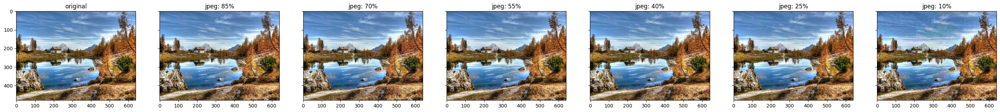

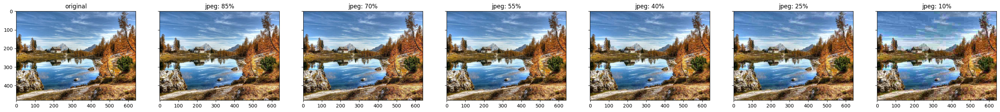

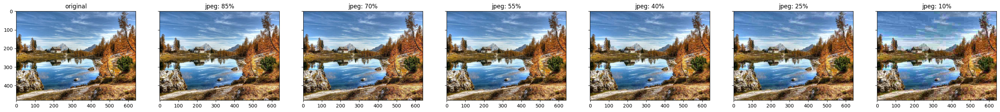

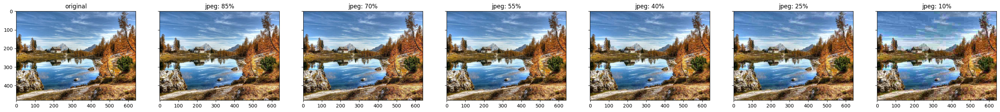

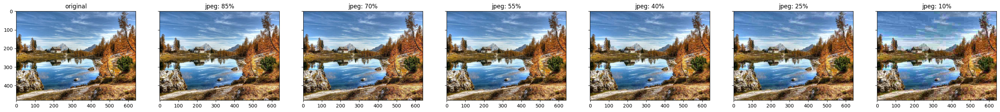

...

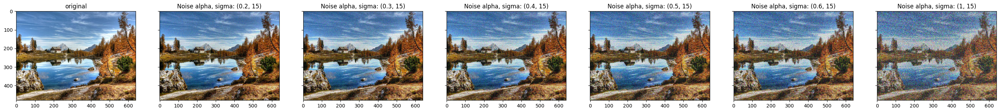

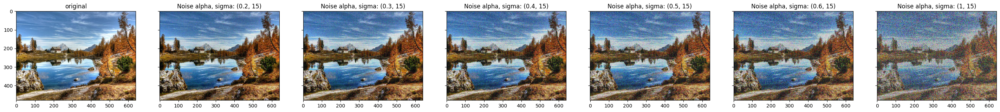

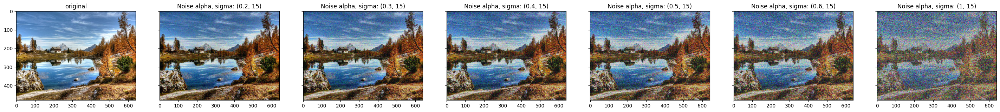

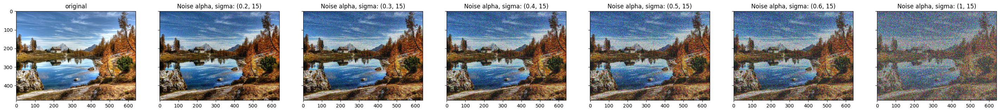

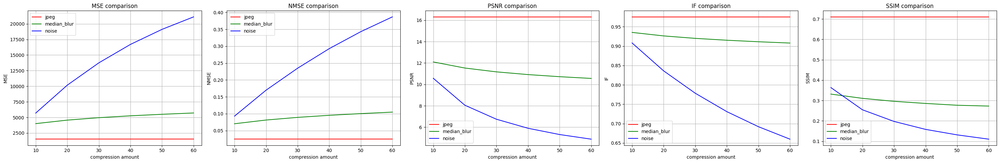

jpeg: 85%
MSE: 3.8894
NMSE: 0.0002
PSNR: 42.2320
IFID: 0.9998
SSIM: 0.9925


jpeg: 70%
MSE: 9.6393
NMSE: 0.0004
PSNR: 38.2903
IFID: 0.9996
SSIM: 0.9832


jpeg: 55%
MSE: 27.7194
NMSE: 0.0011
PSNR: 33.7030
IFID: 0.9989
SSIM: 0.9471


jpeg: 40%
MSE: 32.7609
NMSE: 0.0013
PSNR: 32.9772
IFID: 0.9987
SSIM: 0.9385


jpeg: 25%
MSE: 53.2731
NMSE: 0.0021
PSNR: 30.8657
IFID: 0.9979
SSIM: 0.9049


jpeg: 10%
MSE: 154.7077
NMSE: 0.0061
PSNR: 26.2357
IFID: 0.9939
SSIM: 0.8007


medianBlur_masksize: 3
MSE: 831.9262
NMSE: 0.0214
PSNR: 18.9300
IFID: 0.9794
SSIM: 0.6405


medianBlur_masksize: 5
MSE: 1364.9985
NMSE: 0.0360
PSNR: 16.7795
IFID: 0.9661
SSIM: 0.4750


medianBlur_masksize: 7
MSE: 1779.5208
NMSE: 0.0477
PSNR: 15.6278
IFID: 0.9558
SSIM: 0.4026


medianBlur_masksize: 9
MSE: 2065.2999
NMSE: 0.0560
PSNR: 14.9810
IFID: 0.9488
SSIM: 0.3617


medianBlur_masksize: 11
MSE: 2333.5119
NMSE: 0.0640
PSNR: 14.4507
IFID: 0.9421
SSIM: 0.3327


medianBlur_masksize: 13
MSE: 2582.3284
NMSE: 0.0720
PSNR: 14.0107
IF

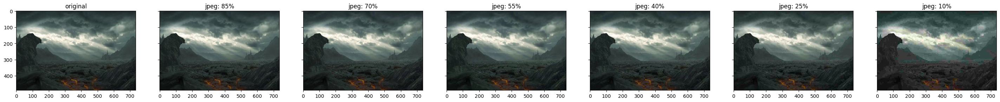

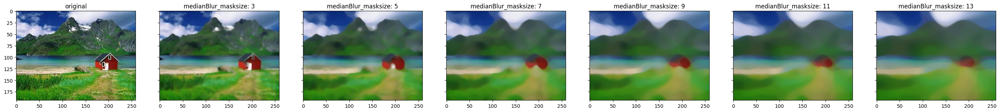

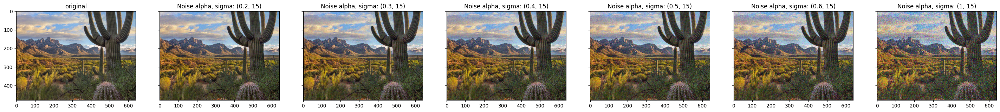

In [ ]:
def lessen_quality(img, compression_method, amount, *args, **kwargs):
    bad_image = img.copy()

    if compression_method == 'jpeg':
        for i in range(amount):
            encode_param = [int(cv2.IMWRITE_JPEG_QUALITY), *args]
            result, encimg = cv2.imencode('.jpg', bad_image, encode_param)
            bad_image = cv2.imdecode(encimg, 1)

    elif compression_method == 'medianBlur':
        for i in range(amount):
            bad_image = cv2.medianBlur(bad_image, *args)

    elif compression_method == 'Noise':
        for i in range(amount):
            alpha, sigma = args
            gauss = np.random.normal(0,sigma,(bad_image.shape))
            bad_image = (bad_image + alpha * gauss).clip(0,255).astype(np.uint8)


    return bad_image


def jpeg_compression(img_path, save_path, how_many_operations, step, how_many_compressions, requested_operation=5):
    results = np.empty((0, 5))
    fig, axs = plt.subplots(1, how_many_operations + 1, sharey=True, figsize=(36, 24))
    img1 = cv2.imread(img_path)
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    axs[0].set_title(f'original')
    axs[0].imshow(img1)

    for i in range(0, how_many_operations):
        j = i + 1
        img2 = lessen_quality(img1, 'jpeg', how_many_compressions, np.clip(100 - j * step, a_min=1, a_max=100))
        axs[j].imshow(img2)
        axs[j].set_title(f'jpeg: {np.clip(100 - j * step, a_min=1, a_max=100)}%')
        print(f'jpeg: {np.clip(100 - j * step, a_min=1, a_max=100)}%')
        print("MSE: {:.4f}".format(mse(img1, img2)))
        print("NMSE: {:.4f}".format(nmse(img1, img2)))
        print("PSNR: {:.4f}".format(psnr(img1, img2)))
        print("IFID: {:.4f}".format(image_fidelity(img1, img2)))
        print("SSIM: {:.4f}".format(ssim_(img1, img2)))
        print("\n")
        if i == requested_operation:
            metrics = np.array([mse(img1, img2), nmse(img1, img2), psnr(img1, img2), image_fidelity(img1, img2), ssim_(img1, img2)])
            results = np.vstack([results, metrics[np.newaxis, :]])

    #plt.subplots_adjust(wspace=0.05, hspace=0)
    plt.savefig(save_path, bbox_inches='tight')
    return results

def median_blur_compression(img_path, save_path, how_many_operations, mask_size, how_many_compressions, requested_operation=5):
    results = np.empty((0, 5))
    fig, axs = plt.subplots(1, how_many_operations + 1 , sharey=True, figsize=(36, 24)) # +1 bo uwzględniam oryginał
    img1 = cv2.imread(img_path)
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    axs[0].set_title(f'original')
    axs[0].imshow(img1)

    for i in range(0, how_many_operations):
        j = i + 1
        img2 = lessen_quality(img1, 'medianBlur', how_many_compressions, mask_size[i])
        axs[j].imshow(img2)
        axs[j].set_title(f'medianBlur_masksize: {mask_size[i]}')
        print(f'medianBlur_masksize: {mask_size[i]}')
        print("MSE: {:.4f}".format(mse(img1, img2)))
        print("NMSE: {:.4f}".format(nmse(img1, img2)))
        print("PSNR: {:.4f}".format(psnr(img1, img2)))
        print("IFID: {:.4f}".format(image_fidelity(img1, img2)))
        print("SSIM: {:.4f}".format(ssim_(img1, img2)))
        print("\n")
        if i == requested_operation:
            metrics = np.array([mse(img1, img2), nmse(img1, img2), psnr(img1, img2), image_fidelity(img1, img2), ssim_(img1, img2)])
            results = np.vstack([results, metrics[np.newaxis, :]])
    plt.savefig(save_path, bbox_inches='tight')
    return results

def noise_compression(img_path, save_path, how_many_operations, alpha, sigma, how_many_compressions, requested_operation=5):
    results = np.empty((0, 5))
    fig, axs = plt.subplots(1, how_many_operations + 1, sharey=True, figsize=(36, 24))
    img1 = cv2.imread(img_path)
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    axs[0].set_title(f'original')
    axs[0].imshow(img1)

    for i in range(0, how_many_operations):
        j = i + 1
        img2 = lessen_quality(img1, 'Noise', how_many_compressions, alpha[i], sigma[i])
        axs[j].imshow(img2)
        axs[j].set_title(f'Noise alpha, sigma: {alpha[i], sigma[i]}')
        print(f'Noise alpha, sigma: {alpha[i], sigma[i]}')
        print("MSE: {:.4f}".format(mse(img1, img2)))
        print("NMSE: {:.4f}".format(nmse(img1, img2)))
        print("PSNR: {:.4f}".format(psnr(img1, img2)))
        print("IFID: {:.4f}".format(image_fidelity(img1, img2)))
        print("SSIM: {:.4f}".format(ssim_(img1, img2)))
        print("\n")
        if i == requested_operation:
            metrics = np.array([mse(img1, img2), nmse(img1, img2), psnr(img1, img2), image_fidelity(img1, img2), ssim_(img1, img2)])
            results = np.vstack([results, metrics[np.newaxis, :]])

    plt.savefig(save_path, bbox_inches='tight')
    return results

#liczba operacji, step, ile kompresji
step = 15
j1 = jpeg_compression('a.jpg', 'j1.jpg', 6, step, 10)
j2 = jpeg_compression('a.jpg', 'j2.jpg', 6, step, 20)
j3 = jpeg_compression('a.jpg', 'j3.jpg', 6, step, 30)
j4 = jpeg_compression('a.jpg', 'j4.jpg', 6, step, 40)
j5 = jpeg_compression('a.jpg', 'j5.jpg', 6, step, 50)
j6 = jpeg_compression('a.jpg', 'j6.jpg', 6, step, 60)

j7 = np.vstack((j1, j2, j3, j4, j5, j6))

print(j7)


median_blurs_kernels = [3, 5, 7, 9, 11, 13]
mb1 = median_blur_compression('a.jpg', 'mb1.jpg', 6, median_blurs_kernels, 10)
mb2 = median_blur_compression('a.jpg', 'mb2.jpg', 6, median_blurs_kernels, 20)
mb3 = median_blur_compression('a.jpg', 'mb3.jpg', 6, median_blurs_kernels, 30)
mb4 = median_blur_compression('a.jpg', 'mb4.jpg', 6, median_blurs_kernels, 40)
mb5 = median_blur_compression('a.jpg', 'mb5.jpg', 6, median_blurs_kernels, 50)
mb6 = median_blur_compression('a.jpg', 'mb6.jpg', 6, median_blurs_kernels, 60)

mb7 = np.vstack((mb1, mb2, mb3, mb4, mb5, mb6))

print(mb7)

noise_compression_alphas = [0.2, 0.3, 0.4, 0.5, 0.6, 1]
noise_compression_sigmas = [15, 15, 15, 15, 15, 15]
nc1 = noise_compression('a.jpg', 'nc1.jpg', 6, noise_compression_alphas, noise_compression_sigmas, 10)
nc2 = noise_compression('a.jpg', 'nc2.jpg', 6, noise_compression_alphas, noise_compression_sigmas, 20)
nc3 = noise_compression('a.jpg', 'nc3.jpg', 6, noise_compression_alphas, noise_compression_sigmas, 30)
nc4 = noise_compression('a.jpg', 'nc4.jpg', 6, noise_compression_alphas, noise_compression_sigmas, 40)
nc5 = noise_compression('a.jpg', 'nc5.jpg', 6, noise_compression_alphas, noise_compression_sigmas, 50)
nc6 = noise_compression('a.jpg', 'nc6.jpg', 6, noise_compression_alphas, noise_compression_sigmas, 60)

nc7 = np.vstack((nc1, nc2, nc3, nc4, nc5, nc6))

print(nc7)

x = np.arange(10, 70, 10)
fig, axs = plt.subplots(1, 5, figsize=(30, 5))

titles = ['MSE comparison', 'NMSE comparison', 'PSNR comparison', 'IF comparison', 'SSIM comparison']
ylabels = ['MSE', 'NMSE', 'PSNR', 'IF', 'SSIM']

for i in range(5):
    axs[i].plot(x, j7[:, i], color='r', label='jpeg')
    axs[i].plot(x, mb7[:, i], color='g', label='median_blur')
    axs[i].plot(x, nc7[:, i], color='b', label='noise')
    axs[i].set_ylabel(ylabels[i])
    axs[i].set_title(titles[i])
    axs[i].legend()
    axs[i].grid(True)
    axs[i].set_xlabel('compression amount')


plt.tight_layout()
plt.savefig('wykesy_porównawcze.jpg')
plt.show()

_ = jpeg_compression('c.jpg', 'results_jpeg.jpg', 6, step, 10)
_ = median_blur_compression('d.jpg', 'results_median_blur.jpg', 6, median_blurs_kernels, 10)
_ = noise_compression('e.jpg', 'results_noise.jpg', 6, noise_compression_alphas, noise_compression_sigmas, 10)

